In [14]:
!pip install pytube pydub transformers torchaudio librosa moviepy openai-whisper yt_dlp torch opencv-python google-colab moviepy ffmpeg

In [15]:
import os
import subprocess
from pytube import YouTube
import whisper
import yt_dlp
import torch
import numpy as np
from moviepy.editor import VideoFileClip

video_url = "https://youtu.be/fLeJJPxua3E?si=TIsDRks0EX6P6CXo"
output_path = './'

def download_youtube_video(video_url, output_path):
    ydl_opts = {
        'format': 'bestvideo+bestaudio',  # Download best video and audio
        'outtmpl': os.path.join(output_path, '%(title)s.%(ext)s'),  # Save to specified output path
    }
    with yt_dlp.YoutubeDL(ydl_opts) as ydl:
        result = ydl.download([video_url])
        video_info = ydl.extract_info(video_url, download=False)
        video_title = video_info.get('title', 'video')
        video_filename = f"{video_title}.webm"
    return os.path.join(output_path, video_filename)

# Download the video
video_path = download_youtube_video(video_url, output_path)

# Convert the downloaded video from .webm to .mp4 using ffmpeg
def convert_to_mp4(input_path, output_path):
    output_file = os.path.join(output_path, 'video.mp4')
    command = ['ffmpeg', '-i', input_path, '-c', 'copy', output_file]
    subprocess.run(command, check=True)
    return output_file

# Convert the downloaded video to mp4
mp4_path = convert_to_mp4(video_path, output_path)
print(f"Video saved as {mp4_path}")
os.remove(video_path)

[youtube] Extracting URL: https://youtu.be/fLeJJPxua3E?si=TIsDRks0EX6P6CXo
[youtube] fLeJJPxua3E: Downloading webpage
[youtube] fLeJJPxua3E: Downloading ios player API JSON
[youtube] fLeJJPxua3E: Downloading web creator player API JSON
[youtube] fLeJJPxua3E: Downloading m3u8 information
[info] fLeJJPxua3E: Downloading 1 format(s): 616+251
[hlsnative] Downloading m3u8 manifest
[hlsnative] Total fragments: 12
[download] Destination: ./Best Short Motivational Speech Video - 24 HOURS - 1-Minute Motivation #2.f616.mp4
[download] 100% of   14.77MiB in 00:00:11 at 1.24MiB/s                 
[download] Destination: ./Best Short Motivational Speech Video - 24 HOURS - 1-Minute Motivation #2.f251.webm
[download] 100% of 1023.35KiB in 00:00:00 at 6.22MiB/s   
[Merger] Merging formats into "./Best Short Motivational Speech Video - 24 HOURS - 1-Minute Motivation #2.webm"
Deleting original file ./Best Short Motivational Speech Video - 24 HOURS - 1-Minute Motivation #2.f251.webm (pass -k to keep)
Dele

In [16]:
import os
from pytube import YouTube
from moviepy.editor import VideoFileClip


def extract_audio_from_video(video_path, audio_output_path):
    video_clip = VideoFileClip(video_path)
    audio_clip = video_clip.audio
    audio_output = os.path.join(audio_output_path, 'audio.mp3')
    audio_clip.write_audiofile(audio_output)
    return audio_output

audio_path = extract_audio_from_video(mp4_path, output_path)

model = whisper.load_model("base")

result = model.transcribe(audio_path)
transcript = result['text']
print("Transcript:", transcript)

MoviePy - Writing audio in ./audio.mp3


MoviePy - Done.


  checkpoint = torch.load(fp, map_location=device)



Transcript:  If you only have 24 hours in a day, your success is dependent upon how you use the 24. You gotta hear me. People talk about open, wren free, you know, care, turn, or warm buffet. Listen to me. I don't care how much money you make. You only get 24 hours in a day. And the difference between Oprah and the person that's broke is Oprah uses her 24 hours wisely. That's it. Listen to me. That's it. You get 24. I don't care if you broke, you grew up broke. I don't care if you grew up rich. I don't care if you're in college. You're not in college. You only get 24 hours. And I blew up literally. I went from being a high school dropout to selling six thousand books in less than six months. What happened? My 24 hours. I was like, okay, Eric, you gotta get a grip on your 24 hours because you bought to be broke for the rest of your life. And that's all I need you to do for me. I can tell you all about your life. If you just write down your 24 hour schedule for me, and you let me look at

In [17]:
import os
from pydub import AudioSegment

def convert_mp3_to_wav(mp3_path, wav_output_path):
    audio = AudioSegment.from_mp3(mp3_path)
    wav_output = os.path.join(wav_output_path, 'audio.wav')
    audio.export(wav_output, format="wav")
    return wav_output

audio_wav_path = convert_mp3_to_wav(audio_path, output_path)

In [18]:
from transformers import AutoModelForAudioClassification, AutoFeatureExtractor
import torch
import librosa

model_name = "r-f/wav2vec-english-speech-emotion-recognition"
model = AutoModelForAudioClassification.from_pretrained(model_name)
feature_extractor = AutoFeatureExtractor.from_pretrained(model_name)

speech_array, sampling_rate = librosa.load('audio.wav', sr=16000)

Some weights of Wav2Vec2ForSequenceClassification were not initialized from the model checkpoint at r-f/wav2vec-english-speech-emotion-recognition and are newly initialized: ['classifier.bias', 'classifier.weight', 'projector.bias', 'projector.weight', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [19]:
import numpy as np
import torch
import torch.nn.functional as F

# Assuming `model` and `feature_extractor` are defined properly in your actual code

# Preprocess the audio
inputs = feature_extractor(speech_array, sampling_rate=sampling_rate, return_tensors="pt", padding=True)

# Move model and inputs to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
inputs = {key: inputs[key].to(device) for key in inputs}

# Make predictions
with torch.no_grad():
    logits = model(**inputs).logits

# Process the results
predicted_ids = torch.argmax(logits, dim=-1).item()
emotions = model.config.id2label
scores = F.softmax(logits, dim=1).cpu().numpy()[0]

# Output the results
speech_emotion_output = [{"Emotion": emotions[i], "Score": f"{score * 100:.2f}%"} for i, score in enumerate(scores)]
print(speech_emotion_output)

# Find the most predicted emotion
most_predicted_index = np.argmax(scores)
most_predicted_emotion = emotions[most_predicted_index]
print(f"Most predicted emotion: {most_predicted_emotion}")

[{'Emotion': 'angry', 'Score': '13.65%'}, {'Emotion': 'disgust', 'Score': '14.63%'}, {'Emotion': 'fear', 'Score': '14.37%'}, {'Emotion': 'happy', 'Score': '14.18%'}, {'Emotion': 'neutral', 'Score': '13.52%'}, {'Emotion': 'sad', 'Score': '15.36%'}, {'Emotion': 'surprise', 'Score': '14.30%'}]
Most predicted emotion: sad


In [20]:
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch.nn.functional as F
import whisper

def process_text(text, num_labels):
    if num_labels == 4:
        model_name = "cardiffnlp/twitter-roberta-base-emotion"
        emotion_labels = ['anger', 'joy', 'optimism', 'sad']
    elif num_labels == 6:
        model_name = "bert-base-uncased"
        emotion_labels = ['anger', 'joy', 'optimism', 'sad', 'fear', 'disgust']
    else:
        raise ValueError("Unexpected number of labels. Please specify either 4 or 6.")

    tokenizer = AutoTokenizer.from_pretrained(model_name)
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)

    inputs = tokenizer(text, return_tensors="pt", truncation=True, max_length=512)
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
    emotion_probs = F.softmax(logits, dim=-1).squeeze()
    predicted_emotion = emotion_labels[torch.argmax(emotion_probs)]
    emotion_dict = {emotion_labels[i]: emotion_probs[i].item() for i in range(len(emotion_labels))}
    return emotion_dict, predicted_emotion

num_labels = 6
emotion_dict, predicted_emotion = process_text(transcript, num_labels)

print("Transcript:", transcript)
print("Emotion Probabilities:", emotion_dict)
print("Predicted Emotion:", predicted_emotion)

  warnings.warn(

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Transcript:  If you only have 24 hours in a day, your success is dependent upon how you use the 24. You gotta hear me. People talk about open, wren free, you know, care, turn, or warm buffet. Listen to me. I don't care how much money you make. You only get 24 hours in a day. And the difference between Oprah and the person that's broke is Oprah uses her 24 hours wisely. That's it. Listen to me. That's it. You get 24. I don't care if you broke, you grew up broke. I don't care if you grew up rich. I don't care if you're in college. You're not in college. You only get 24 hours. And I blew up literally. I went from being a high school dropout to selling six thousand books in less than six months. What happened? My 24 hours. I was like, okay, Eric, you gotta get a grip on your 24 hours because you bought to be broke for the rest of your life. And that's all I need you to do for me. I can tell you all about your life. If you just write down your 24 hour schedule for me, and you let me look at

In [21]:
import numpy as np

# # Speech emotion recognition output
# speech_emotion_output = scores

# # Text emotion recognition output
# text_emotion_output = emotion_dict

speech_emotion_probs = np.array([float(d['Score'].replace('%', '')) / 100 for d in speech_emotion_output])
text_emotion_probs = np.array(list(emotion_dict.values()))

max_length = max(len(speech_emotion_probs), len(text_emotion_probs))
speech_emotion_probs = np.pad(speech_emotion_probs, (0, max_length - len(speech_emotion_probs)), mode='constant', constant_values=0)
text_emotion_probs = np.pad(text_emotion_probs, (0, max_length - len(text_emotion_probs)), mode='constant', constant_values=0)

combined_emotion_probs = (speech_emotion_probs + text_emotion_probs) / 2

emotion_labels = ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise', 'anger', 'joy', 'optimism', 'sadness', 'fear', 'disgust']
most_predicted_index = np.argmax(combined_emotion_probs)
most_predicted_emotion = emotion_labels[most_predicted_index]

combined_emotion_vector = [f"{emotion_labels[i]}:{combined_emotion_probs[i]:.4f}" for i in range(len(combined_emotion_probs))]

print("Combined Emotion Vector:", combined_emotion_vector)
print("Most predicted emotion:", most_predicted_emotion)


Combined Emotion Vector: ['angry:0.1487', 'disgust:0.1741', 'fear:0.1603', 'happy:0.1146', 'neutral:0.1692', 'sad:0.1617', 'surprise:0.0715']
Most predicted emotion: disgust


  warnings.warn(



Frame 0: Emotion Vector: [0.04595964 0.0141664  0.03538018 0.0364196  0.2705282  0.25991425
 0.33763176]


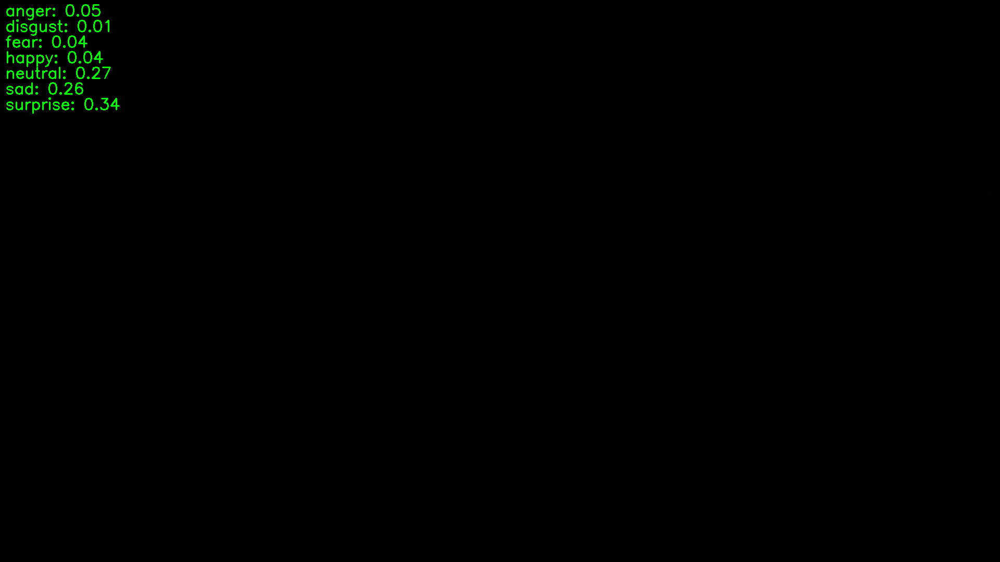

Frame 60: Emotion Vector: [0.03599999 0.80738413 0.04646334 0.00227811 0.00808941 0.0068903
 0.0928947 ]


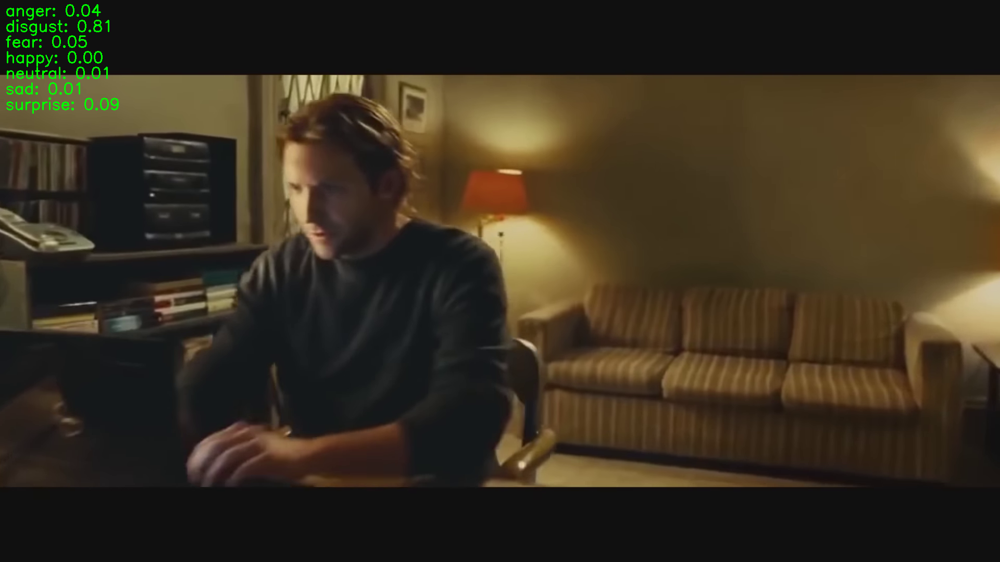

Frame 120: Emotion Vector: [0.05414018 0.4227718  0.05625661 0.00484727 0.03868789 0.01269637
 0.41059986]


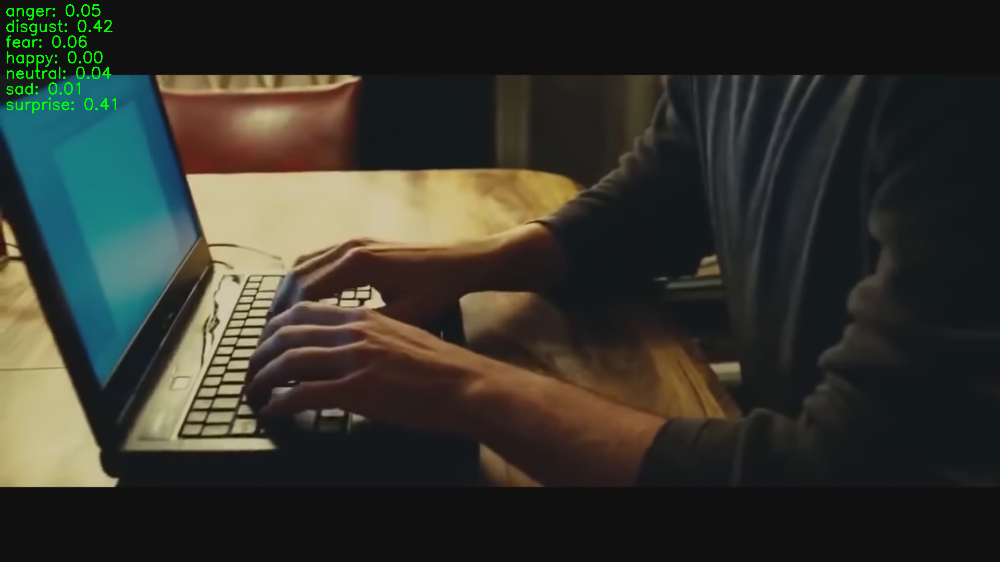

Frame 180: Emotion Vector: [0.00513478 0.00746635 0.96812797 0.00149935 0.0013745  0.00282166
 0.01357528]


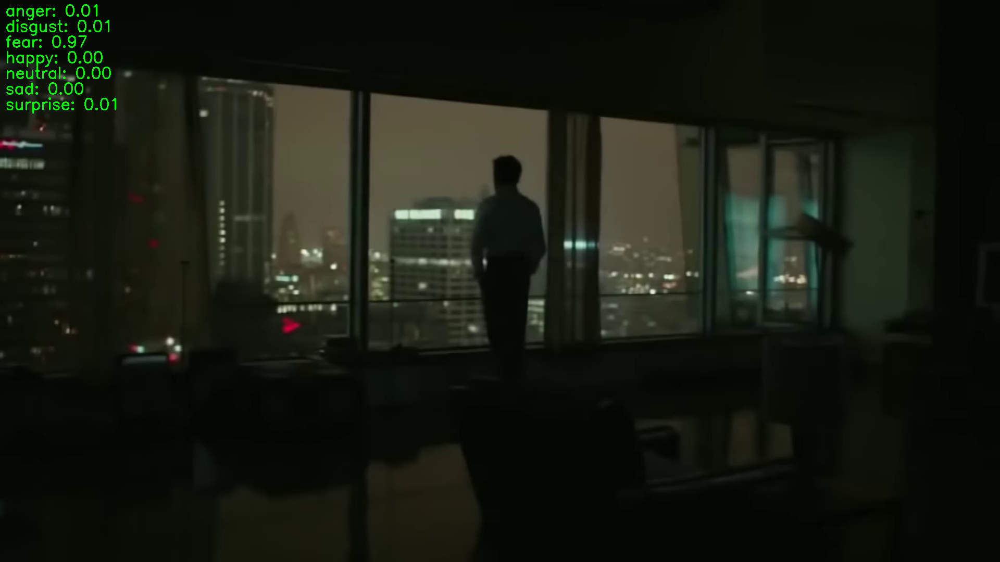

Frame 240: Emotion Vector: [0.04068539 0.08752256 0.5835437  0.00904549 0.01462706 0.00955026
 0.25502542]


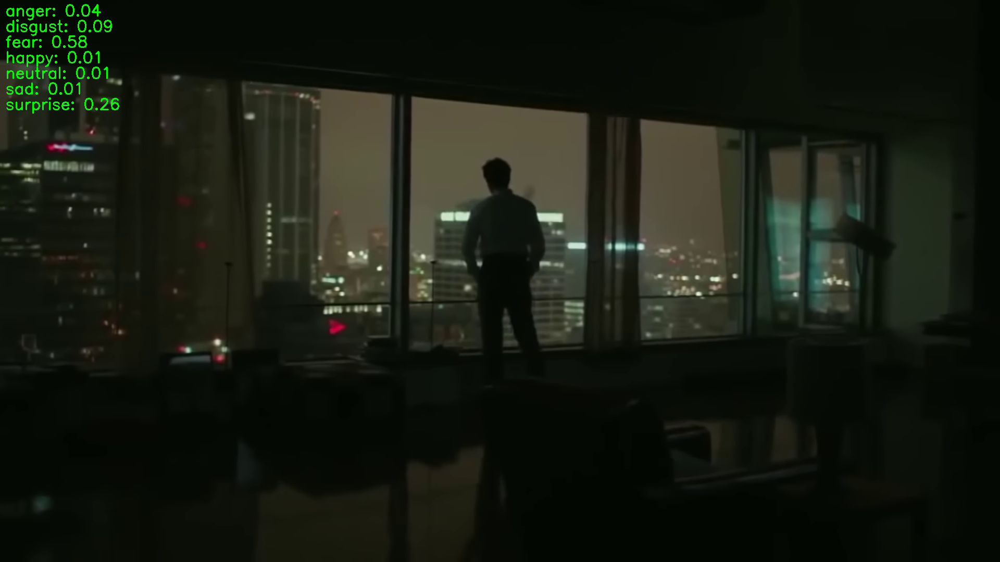

Frame 300: Emotion Vector: [0.02455514 0.01688259 0.82093674 0.00963802 0.0049319  0.00243764
 0.12061788]


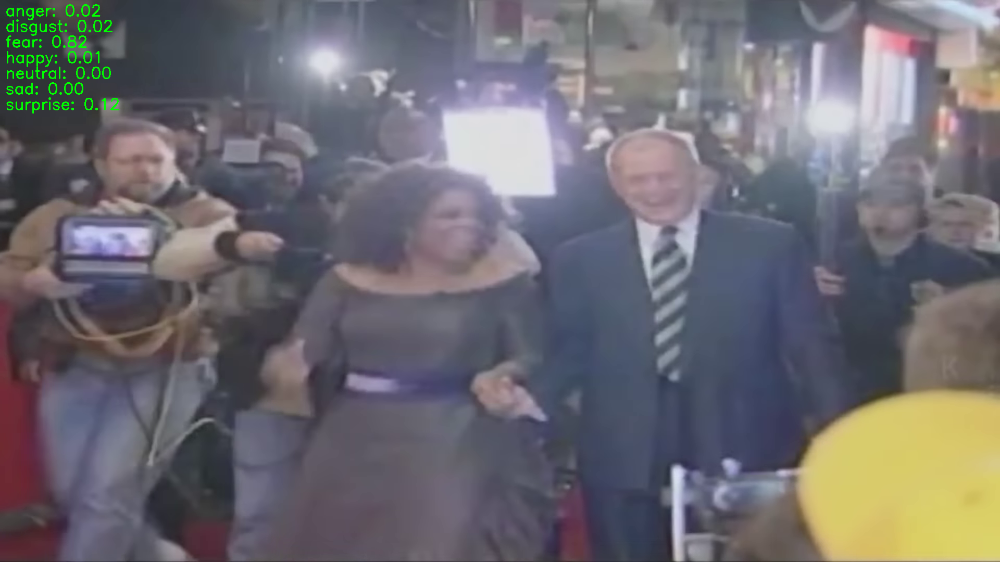

Frame 360: Emotion Vector: [0.07048824 0.41236386 0.12095346 0.01457797 0.02602109 0.0120472
 0.3435482 ]


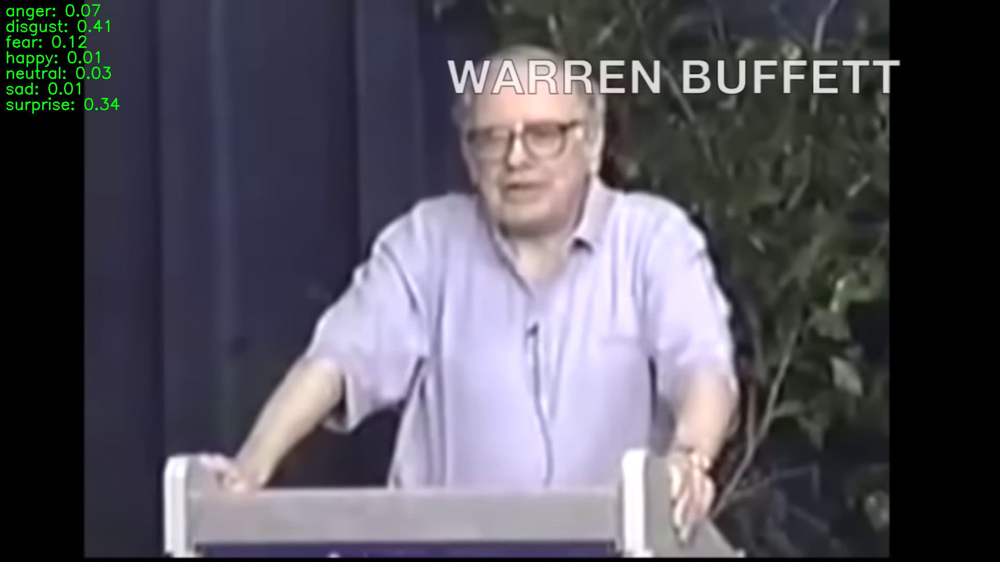

Frame 420: Emotion Vector: [0.00465599 0.00243936 0.01043555 0.06818308 0.06078617 0.00749501
 0.8460048 ]


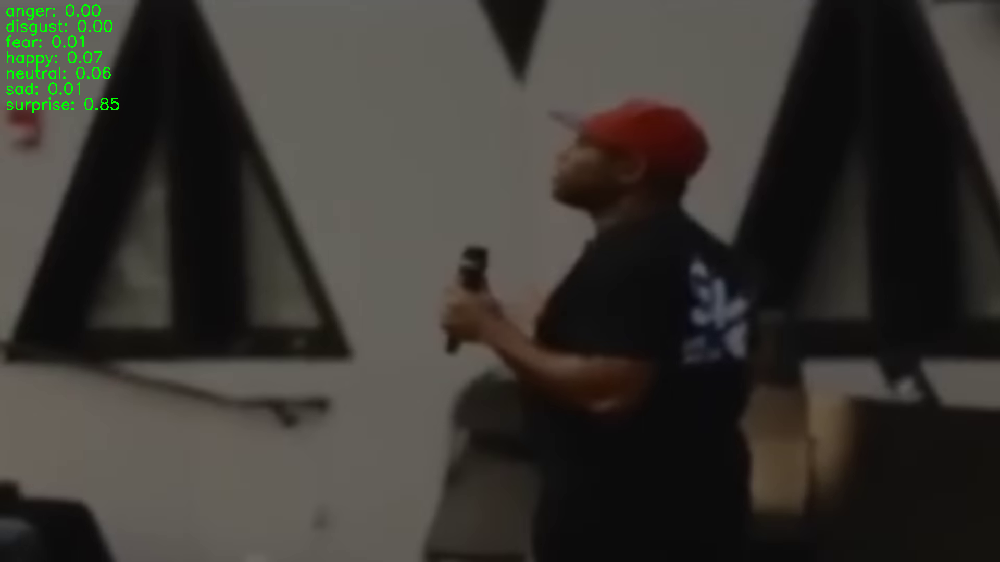

Frame 480: Emotion Vector: [0.04509458 0.38105404 0.19548671 0.0101373  0.01249896 0.00910675
 0.34662163]


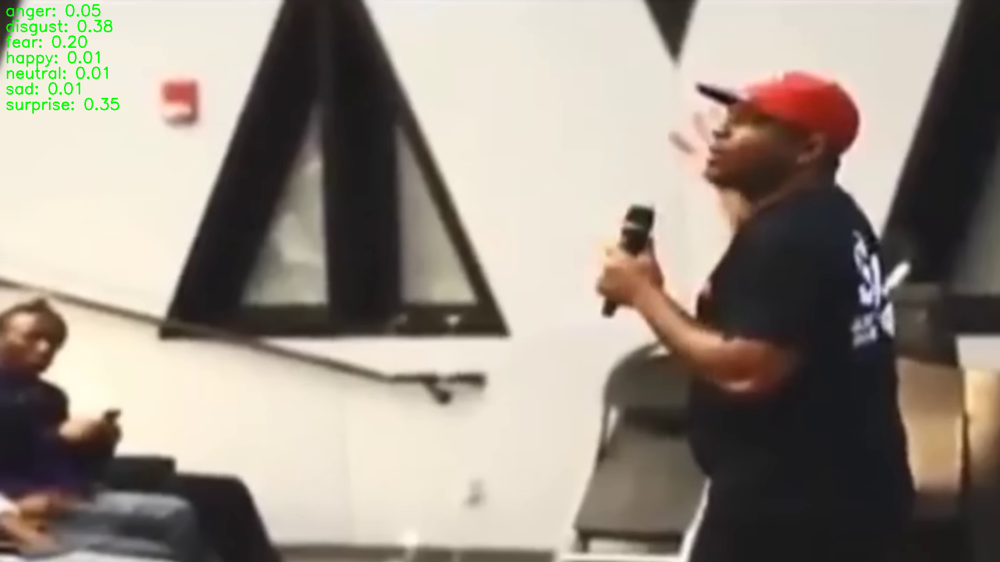

Frame 540: Emotion Vector: [0.05471401 0.13470581 0.37185323 0.01741995 0.0277433  0.00848208
 0.38508162]


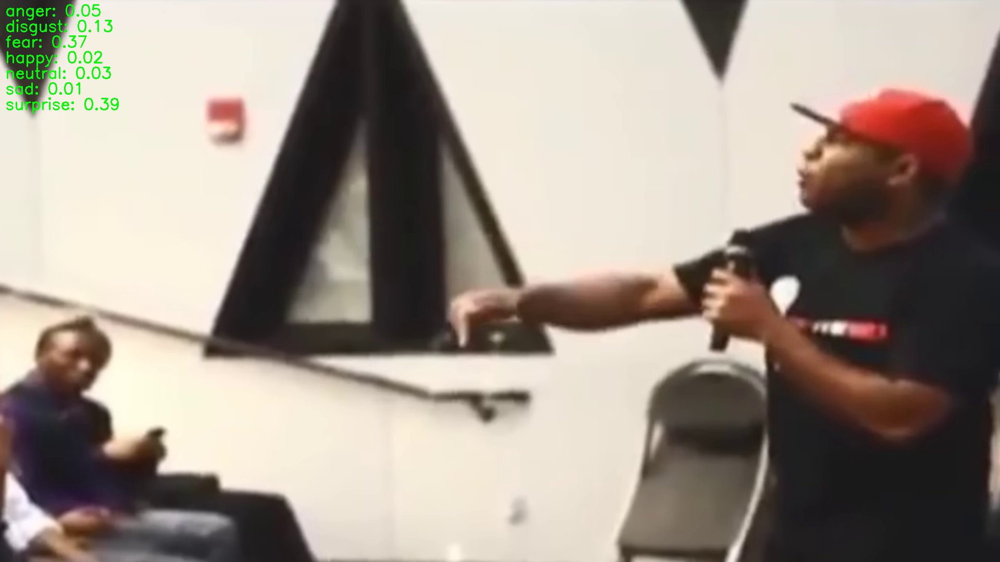

Frame 600: Emotion Vector: [0.04509458 0.38105404 0.19548671 0.0101373  0.01249896 0.00910675
 0.34662163]


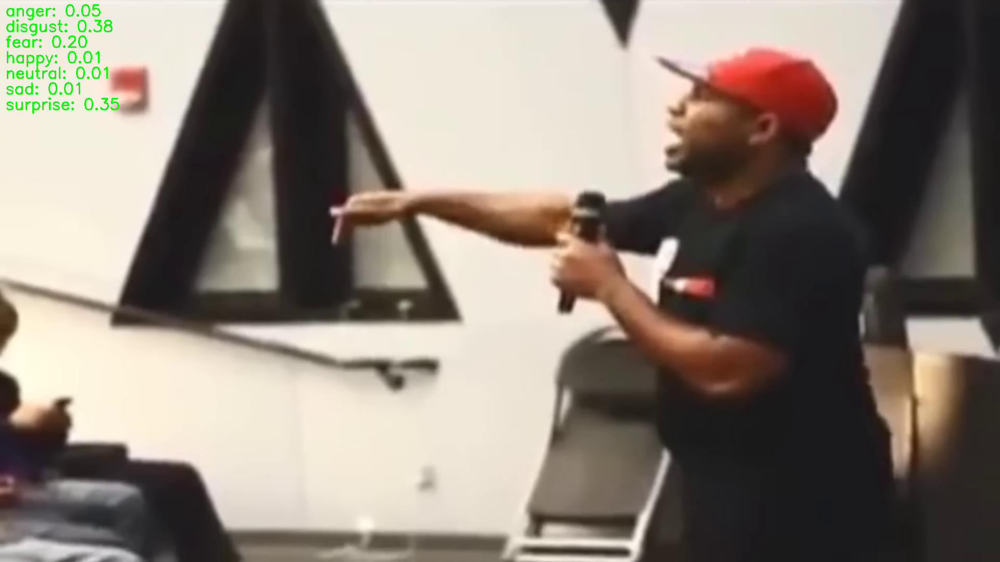

Frame 660: Emotion Vector: [0.04253808 0.54688746 0.24938865 0.01572829 0.01367026 0.00929817
 0.12248908]


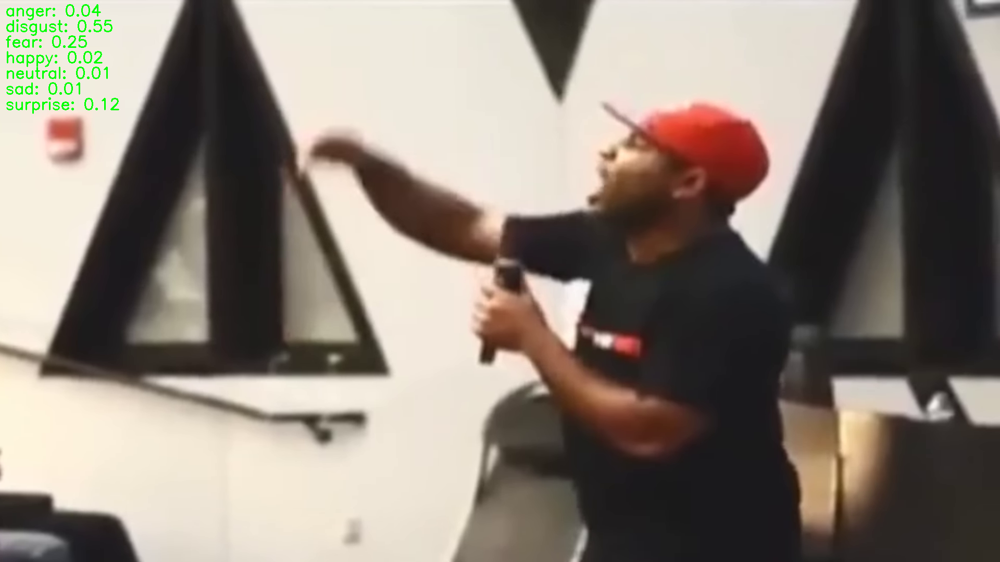

Frame 720: Emotion Vector: [0.10395321 0.27939177 0.39205214 0.00874043 0.01369618 0.00931657
 0.1928497 ]


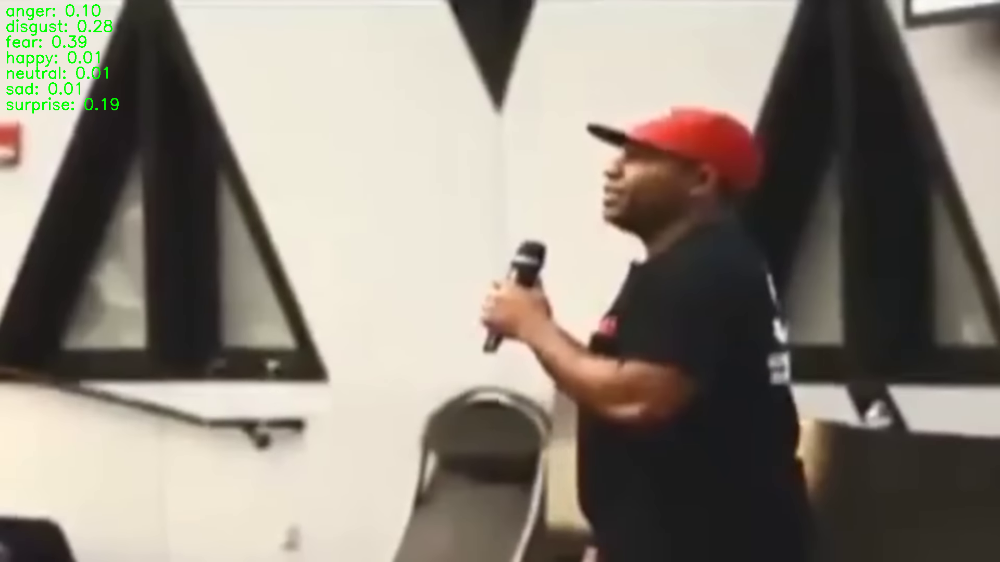

Frame 780: Emotion Vector: [0.03234471 0.01493249 0.30846646 0.03945261 0.01746763 0.00469817
 0.58263785]


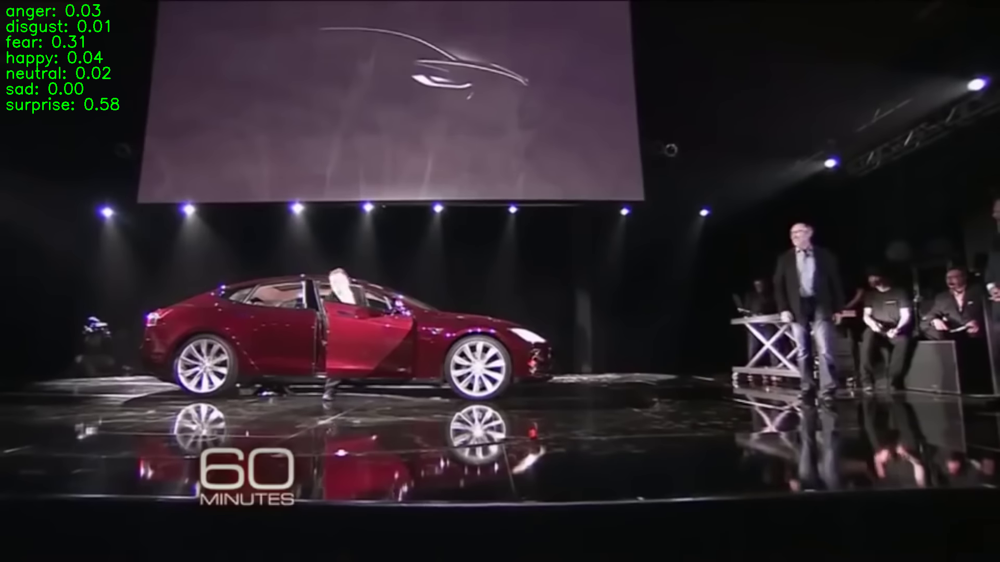

Frame 840: Emotion Vector: [0.02361535 0.04030114 0.01533676 0.03170136 0.22612692 0.01112089
 0.65179753]


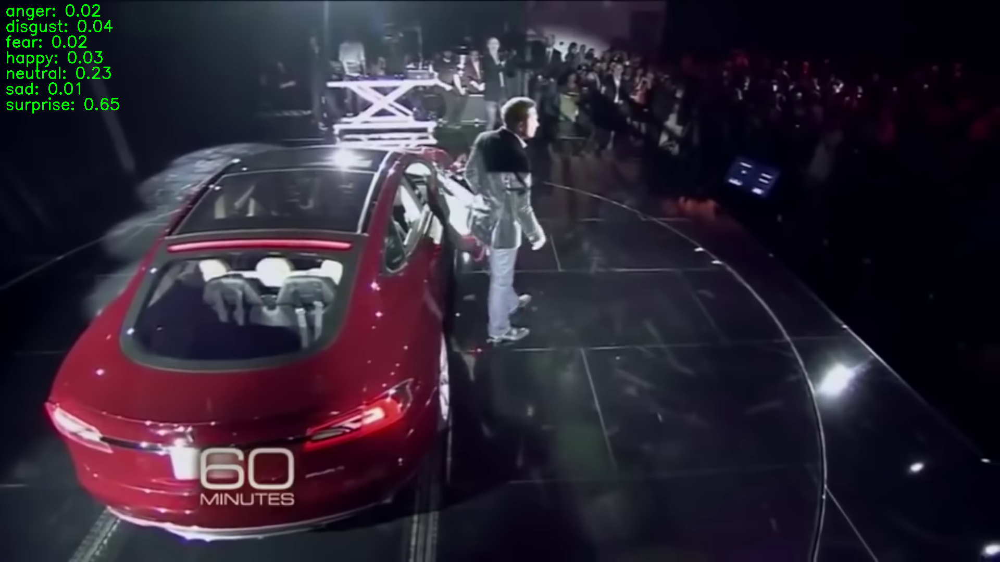

Frame 900: Emotion Vector: [0.03748445 0.08294504 0.46103656 0.0081722  0.0072716  0.00353079
 0.39955938]


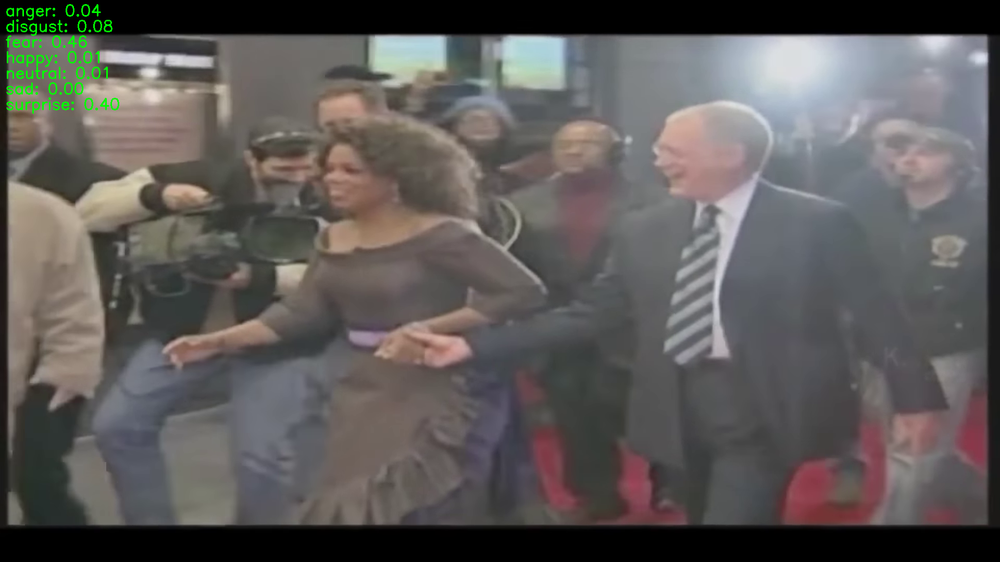

Frame 960: Emotion Vector: [0.02455514 0.01688259 0.82093674 0.00963802 0.0049319  0.00243764
 0.12061788]


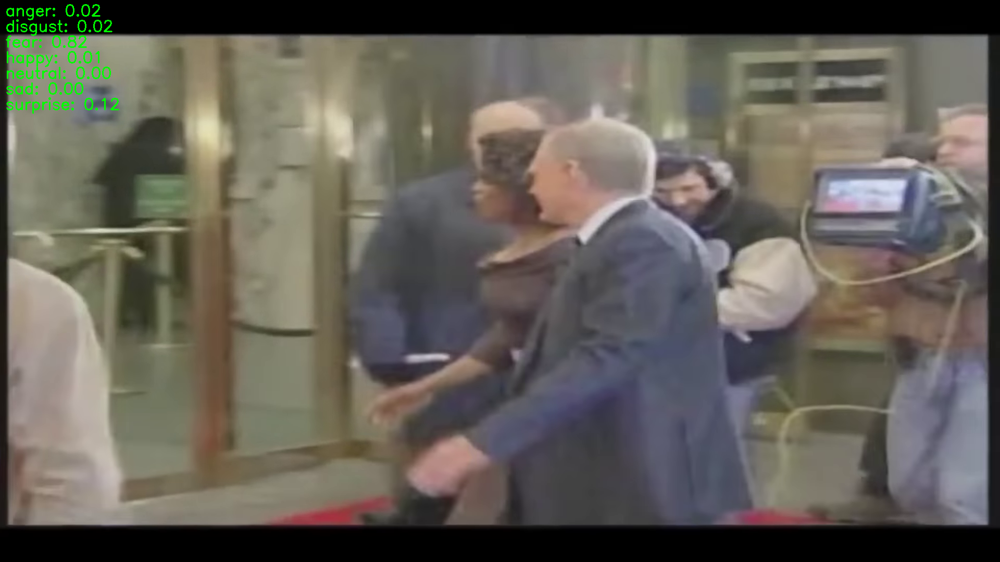

Frame 1020: Emotion Vector: [0.06852666 0.6574581  0.16334777 0.0036987  0.00715604 0.00624249
 0.09357028]


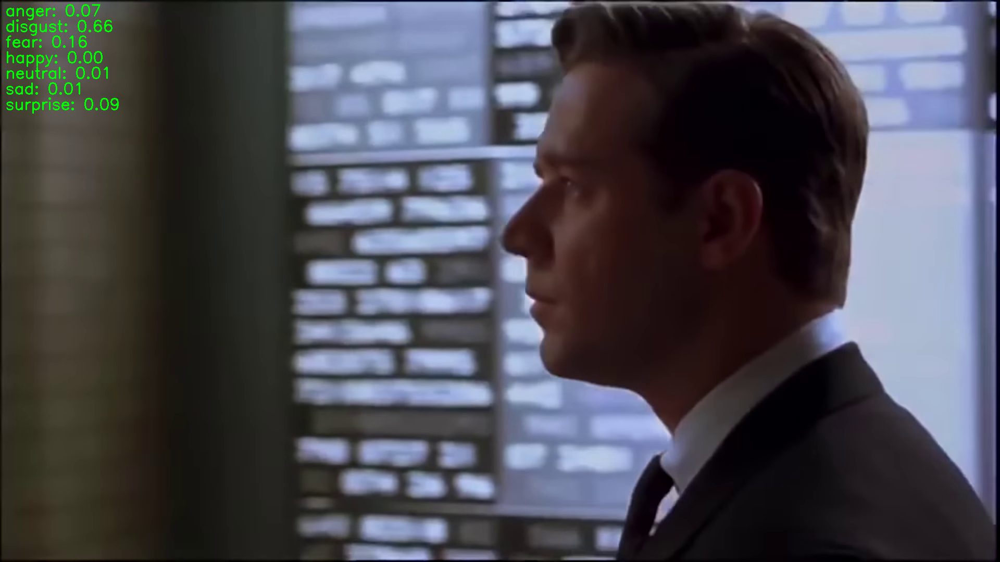

Frame 1080: Emotion Vector: [0.05325482 0.33044842 0.32510588 0.01082476 0.01584251 0.00839434
 0.2561294 ]


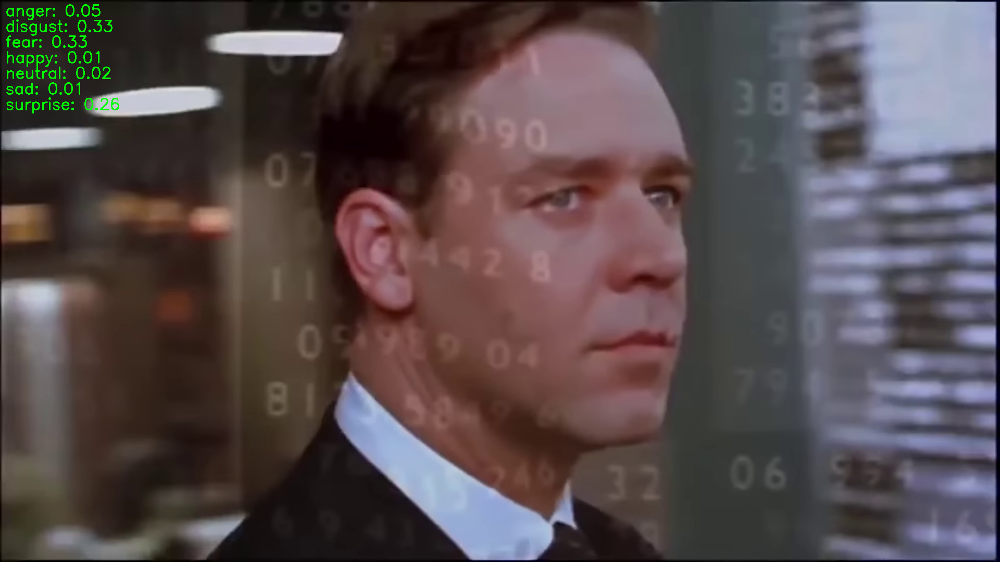

Frame 1140: Emotion Vector: [0.01024729 0.0121205  0.01900133 0.01102299 0.01475058 0.00621415
 0.9266432 ]


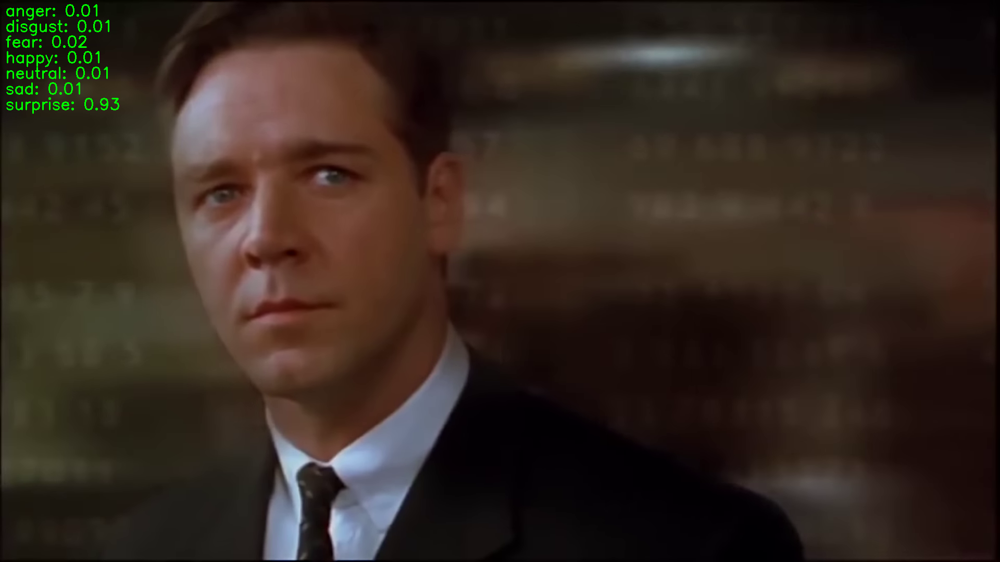

Frame 1200: Emotion Vector: [0.06778032 0.89198273 0.01852022 0.00096239 0.00834213 0.00336974
 0.00904228]


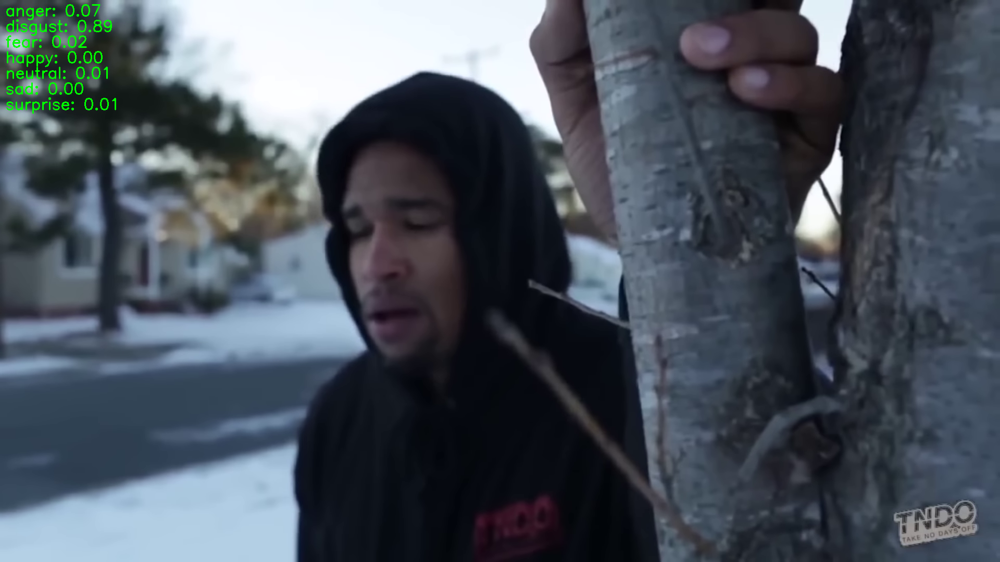

Frame 1260: Emotion Vector: [0.07108276 0.08964985 0.1944849  0.0205442  0.05324376 0.02053073
 0.55046386]


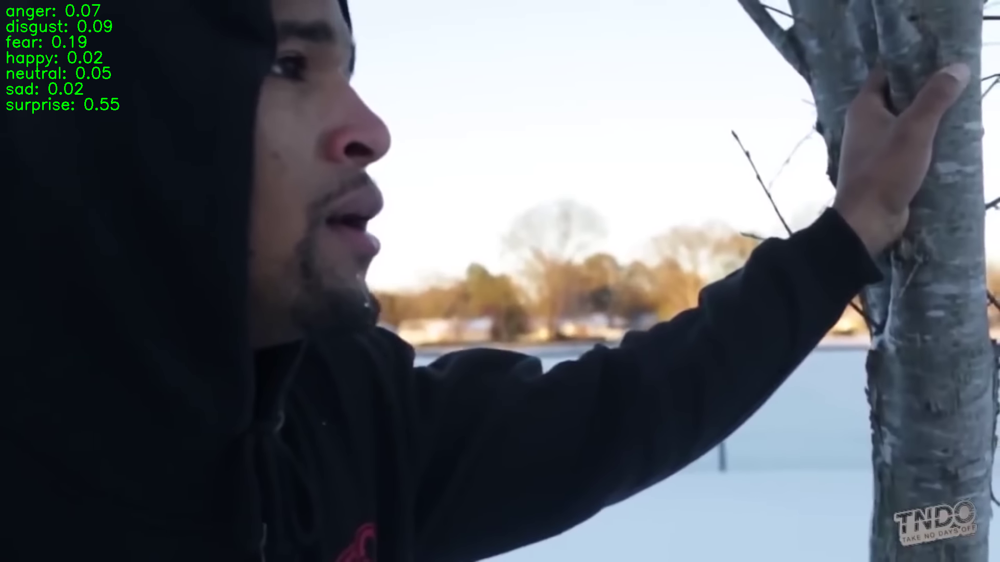

Frame 1320: Emotion Vector: [0.06383056 0.12335046 0.14150383 0.0152989  0.08266167 0.01540403
 0.5579506 ]


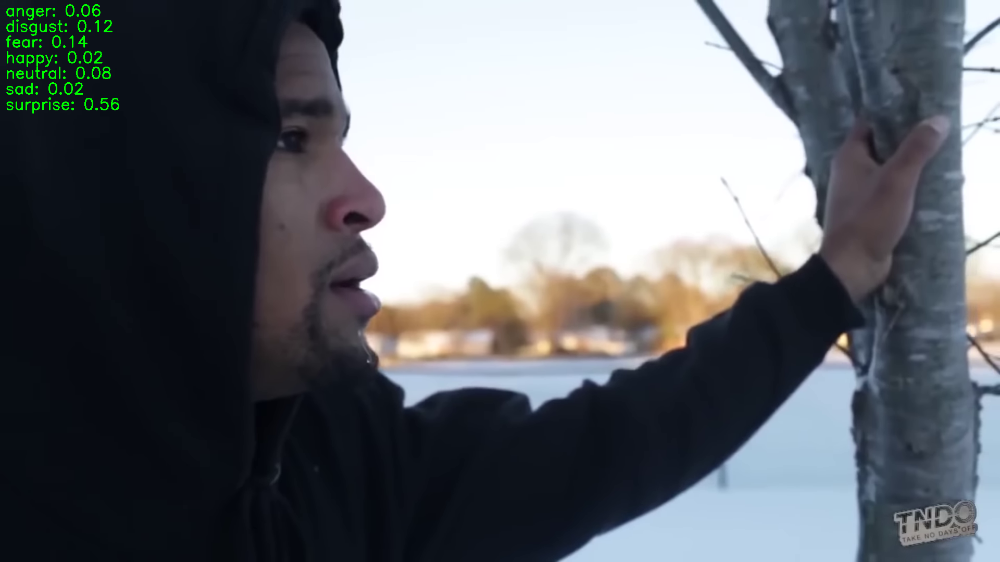

Frame 1380: Emotion Vector: [0.04818014 0.127777   0.66872936 0.00720638 0.00926859 0.00553949
 0.13329898]


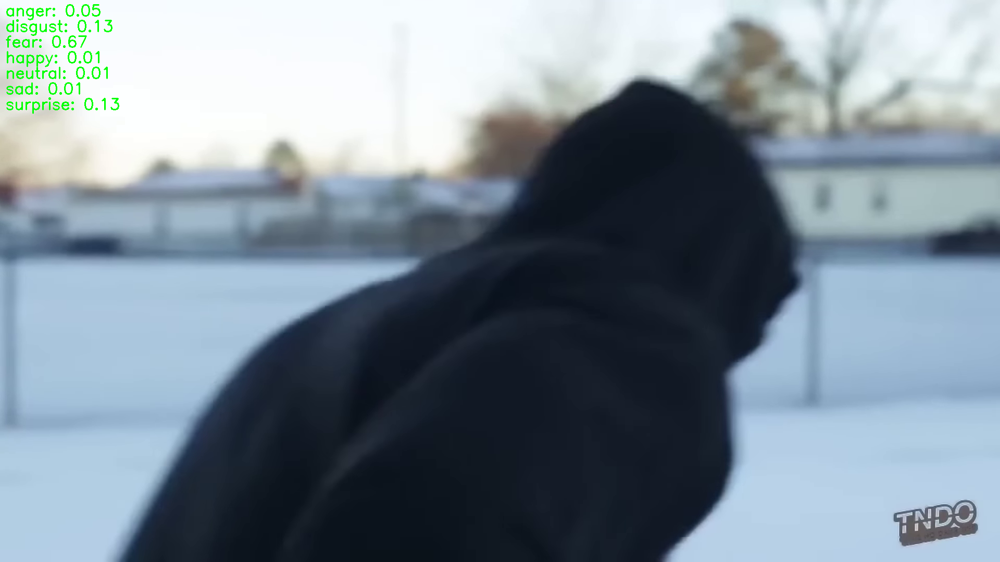

Frame 1440: Emotion Vector: [0.03069861 0.01057472 0.11890122 0.16192521 0.01737925 0.00845302
 0.65206796]


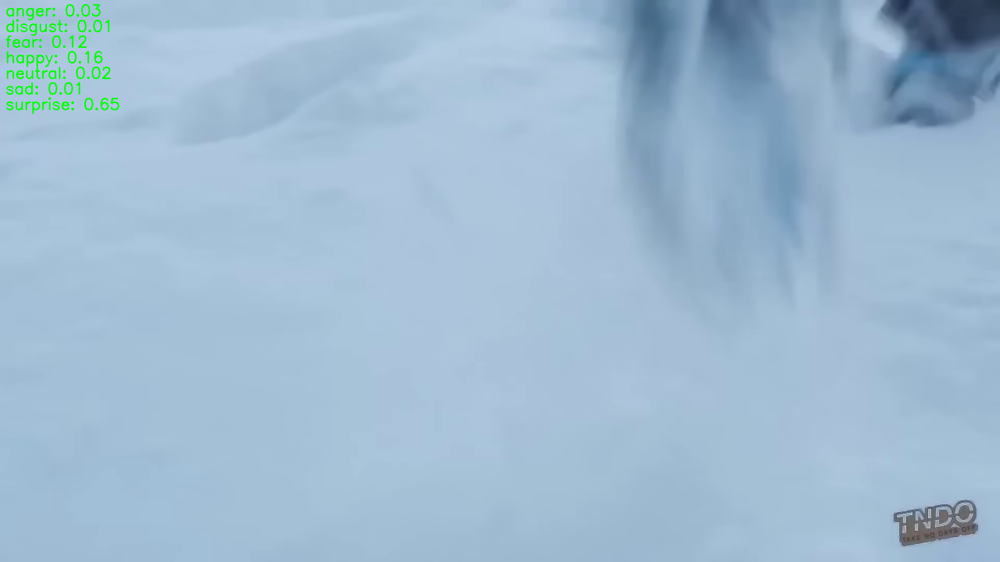

Frame 1500: Emotion Vector: [0.07513432 0.587311   0.05053608 0.01191812 0.02878304 0.01521647
 0.23110098]


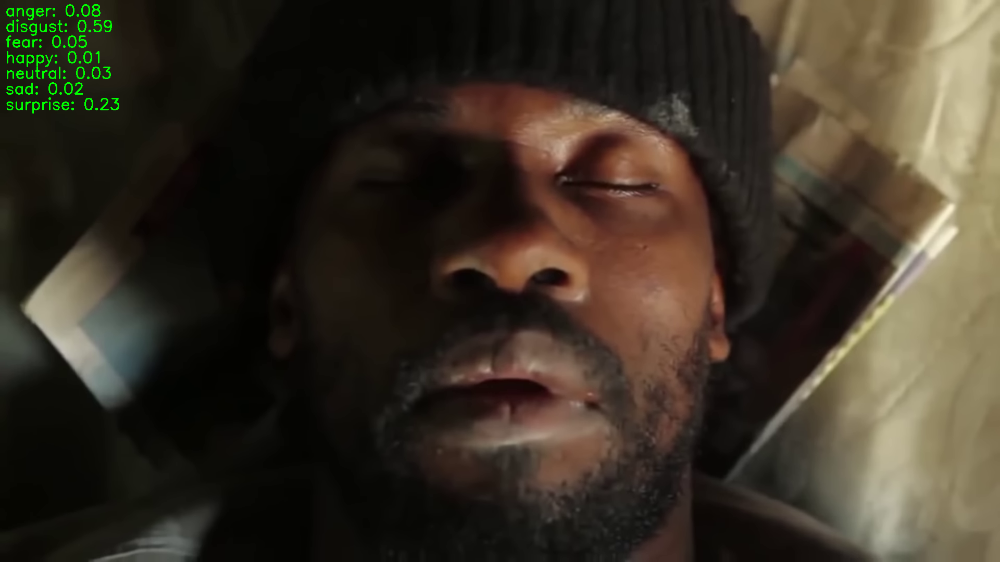

Frame 1560: Emotion Vector: [0.03409603 0.8122338  0.03122242 0.00591122 0.02459361 0.01489872
 0.07704422]


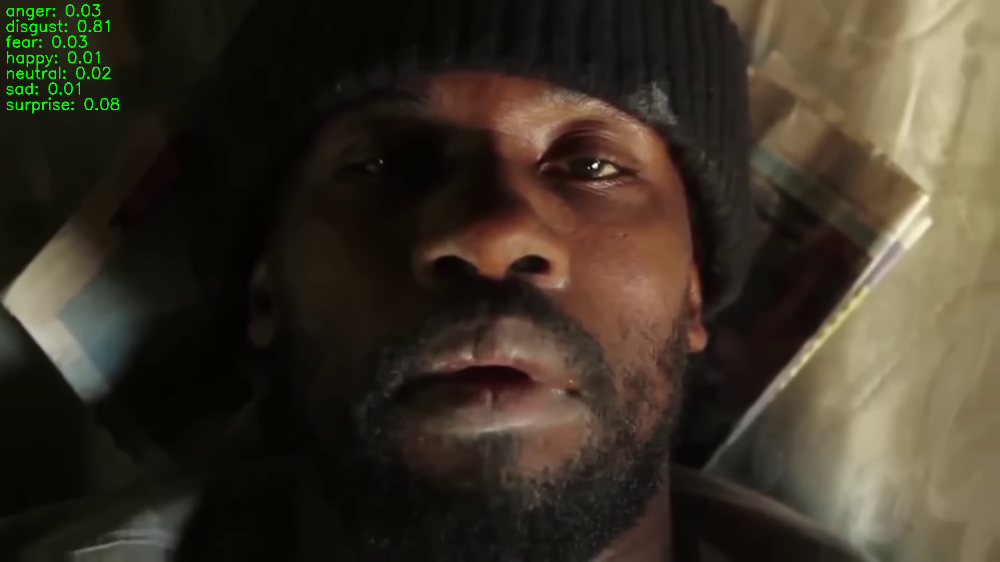

Frame 1620: Emotion Vector: [1.8823199e-02 9.5953786e-01 9.7368686e-03 4.0373014e-04 2.0217102e-03
 4.6776044e-03 4.7991122e-03]


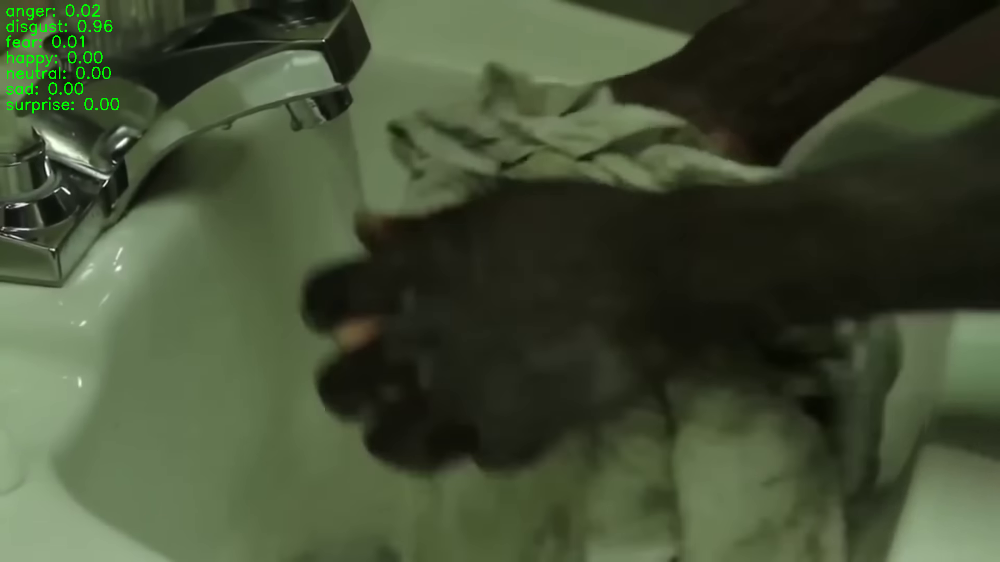

Frame 1680: Emotion Vector: [1.3884746e-03 9.4877189e-04 9.8790979e-01 7.1720983e-04 1.2361880e-03
 9.8515500e-04 6.8143769e-03]


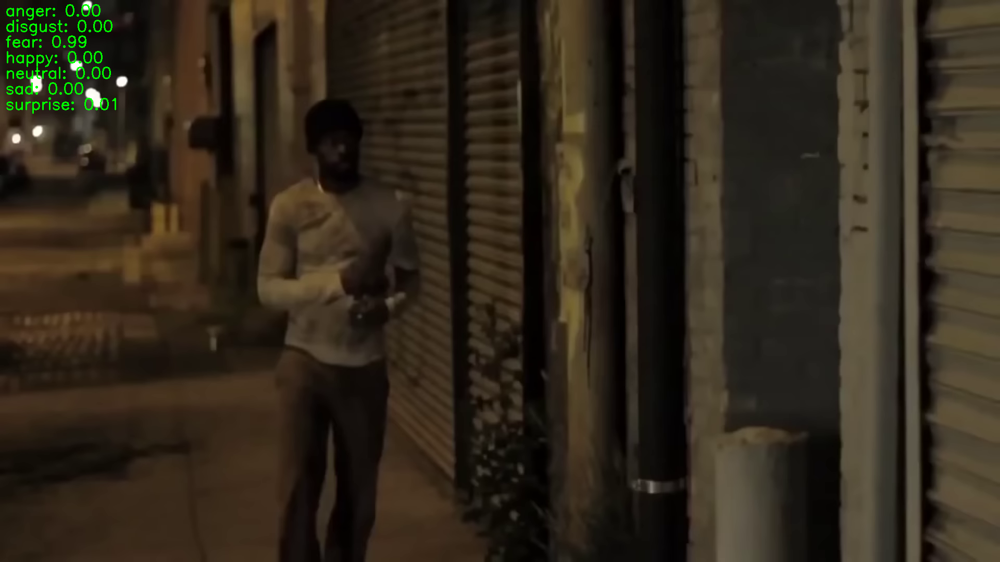

Frame 1740: Emotion Vector: [1.8516200e-03 2.1845053e-03 9.8924154e-01 6.7166588e-04 6.0679635e-04
 1.4598069e-03 3.9839181e-03]


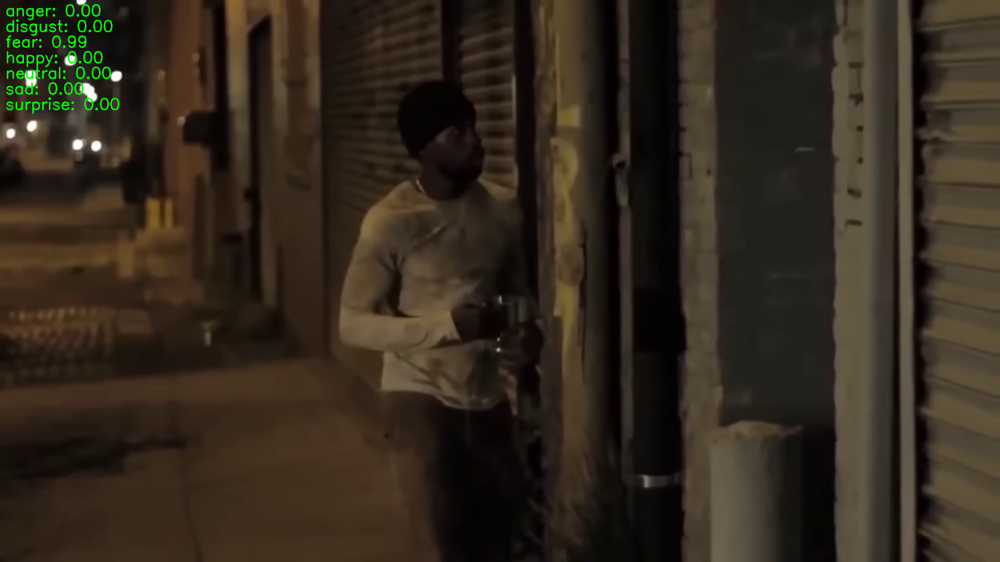

Frame 1800: Emotion Vector: [0.00940761 0.87788194 0.00450453 0.00183437 0.03867931 0.00722116
 0.06047111]


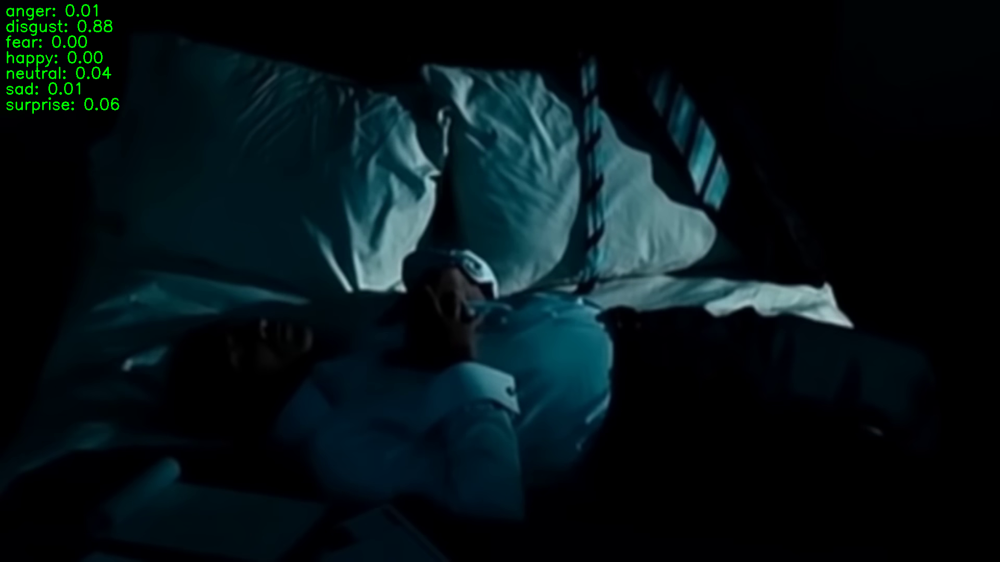

Frame 1860: Emotion Vector: [0.12945694 0.38792717 0.18514527 0.00812992 0.0081861  0.01877
 0.2623846 ]


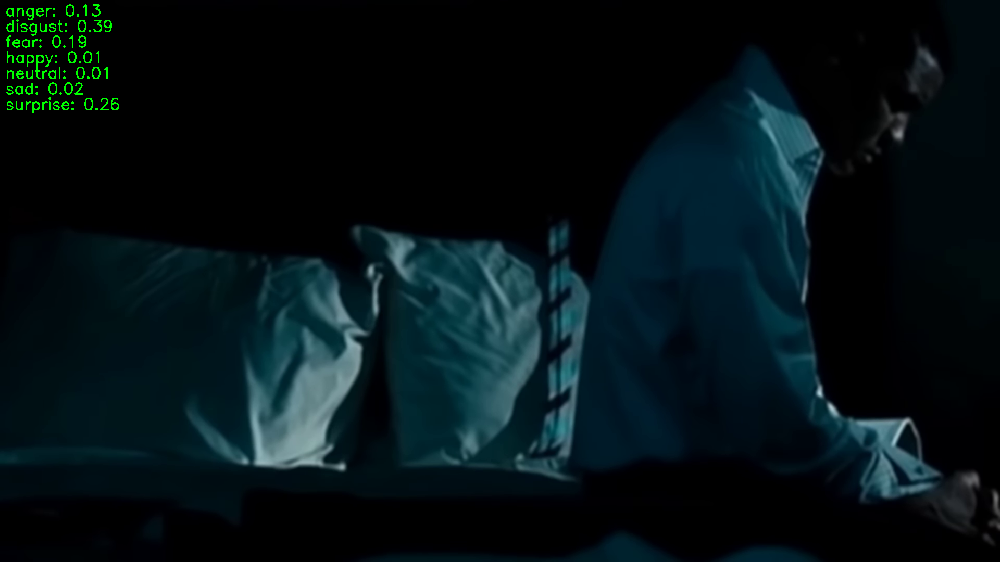

Frame 1920: Emotion Vector: [0.30358547 0.3892606  0.2487406  0.00300683 0.0133407  0.01553845
 0.02652718]


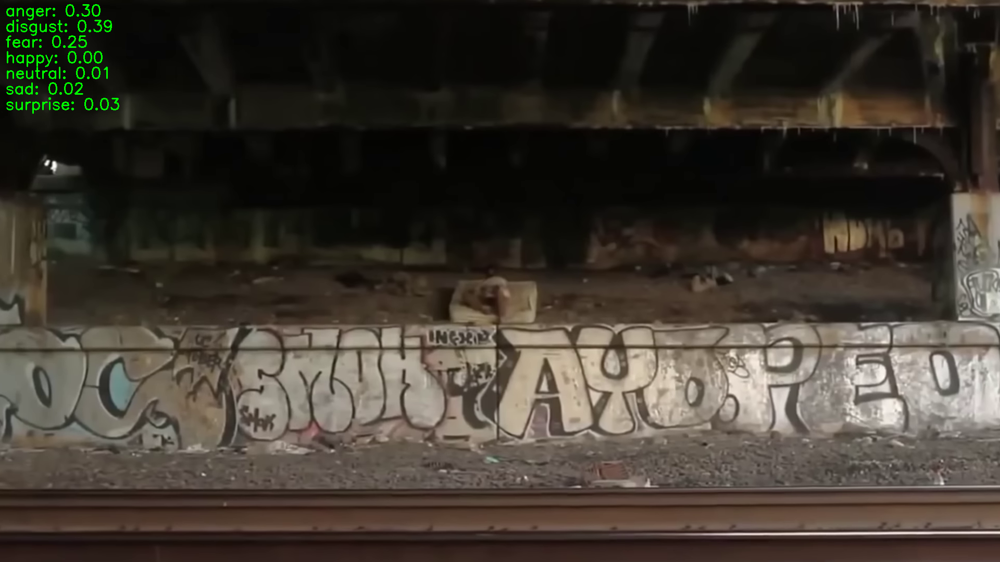

Frame 1980: Emotion Vector: [0.01031088 0.00403822 0.00177363 0.05668783 0.3123901  0.03964834
 0.575151  ]


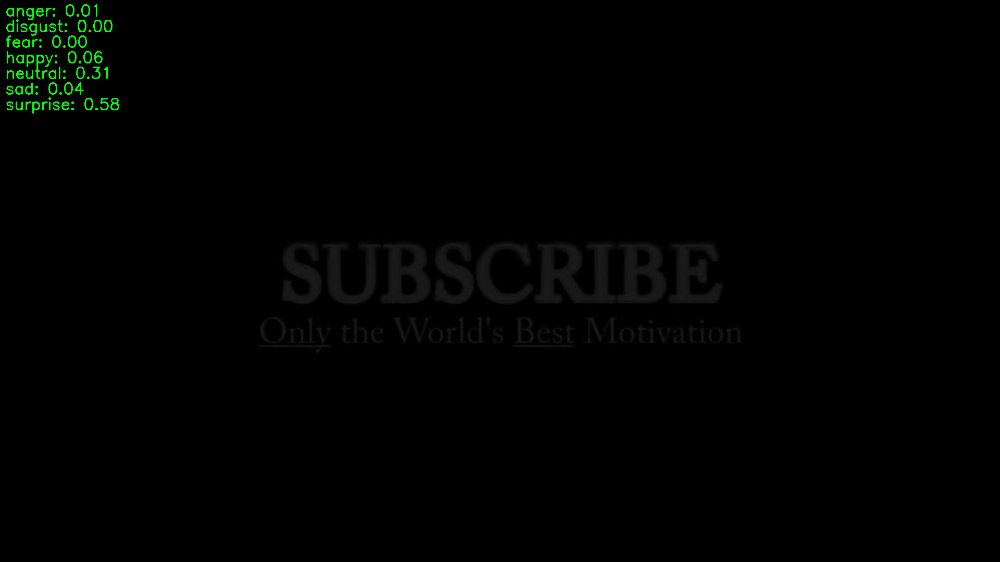

Aggregate Emotion Vector: [0.04966674 0.29158345 0.2885455  0.01818767 0.04115982 0.01686806
 0.29398873]
Most Predicted Emotion: neutral


In [22]:
import torch
from transformers import BlipProcessor, BlipForConditionalGeneration, AutoModelForSequenceClassification, AutoTokenizer
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from pytube import YouTube
import os

caption_model_name = "Salesforce/blip-image-captioning-base"
caption_processor = BlipProcessor.from_pretrained(caption_model_name)
caption_model = BlipForConditionalGeneration.from_pretrained(caption_model_name)

# Load the emotion recognition model and tokenizer
emotion_model_name = "j-hartmann/emotion-english-distilroberta-base"
emotion_tokenizer = AutoTokenizer.from_pretrained(emotion_model_name)
emotion_model = AutoModelForSequenceClassification.from_pretrained(emotion_model_name)

# Preprocess the video frames and generate text descriptions
def preprocess_frame(frame):
    frame = cv2.resize(frame, (224, 224))
    pixel_values = caption_processor(images=frame, return_tensors="pt").pixel_values
    return pixel_values

# Generate image captions
def generate_caption(pixel_values):
    caption_ids = caption_model.generate(pixel_values)
    caption = caption_processor.batch_decode(caption_ids, skip_special_tokens=True)[0]
    return caption

# Predict emotions based on text description
def predict_emotions(caption):
    inputs = emotion_tokenizer(caption, return_tensors='pt', truncation=True, padding=True)
    outputs = emotion_model(**inputs)
    emotion_probs = torch.softmax(outputs.logits, dim=1)
    emotion_labels = ['anger', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']
    predicted_emotions = {label: prob.item() for label, prob in zip(emotion_labels, emotion_probs[0])}
    return predicted_emotions, emotion_probs[0]

# Sampling parameters
n_frame_interval = 60  # Process every 60th frame
emotion_vectors = []

# Process the video
video = cv2.VideoCapture(mp4_path)
total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

frame_count = 0

while video.isOpened():
    ret, frame = video.read()

    if not ret or frame_count > total_frames:
        break

    if frame_count % n_frame_interval == 0:
        pixel_values = preprocess_frame(frame)
        caption = generate_caption(pixel_values)
        predicted_emotions, emotion_vector = predict_emotions(caption)

        # Collect emotion vectors
        emotion_vectors.append(emotion_vector.detach().cpu().numpy())

        # Print the emotion vector
        print(f"Frame {frame_count}: Emotion Vector: {emotion_vector.detach().cpu().numpy()}")

        # Annotate frame with predicted emotions
        for emotion, prob in predicted_emotions.items():
            cv2.putText(frame, f"{emotion}: {prob:.2f}", (10, 30 + 30 * list(predicted_emotions.keys()).index(emotion)), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        cv2_imshow(frame)

    frame_count += 1

video.release()
cv2.destroyAllWindows()

# Aggregate results
emotion_labels = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise', 'neutral']
average_emotion_vector = np.mean(emotion_vectors, axis=0)
most_predicted_emotion = emotion_labels[np.argmax(average_emotion_vector)]

print(f"Aggregate Emotion Vector: {average_emotion_vector}")
print(f"Most Predicted Emotion: {most_predicted_emotion}")


In [23]:
# Combine the average emotion vector from video with the combined speech-text emotion vector
combined_video_emotion_probs = np.pad(average_emotion_vector, (0, len(combined_emotion_probs) - len(average_emotion_vector)), mode='constant', constant_values=0)
final_combined_emotion_probs = (combined_emotion_probs + combined_video_emotion_probs) / 2

# Final combined emotion label
final_most_predicted_index = np.argmax(final_combined_emotion_probs)
final_most_predicted_emotion = emotion_labels[final_most_predicted_index]

final_combined_emotion_vector = [f"{emotion_labels[i]}:{final_combined_emotion_probs[i]:.4f}" for i in range(len(final_combined_emotion_probs))]

# Output
print("Final Combined Emotion Vector:", final_combined_emotion_vector)
print("Final Most Predicted Emotion:", final_most_predicted_emotion)


Final Combined Emotion Vector: ['anger:0.0992', 'disgust:0.2328', 'fear:0.2244', 'joy:0.0664', 'sadness:0.1052', 'surprise:0.0893', 'neutral:0.1827']
Final Most Predicted Emotion: disgust
